In [1]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr

from matplotlib.colors import BoundaryNorm
import cartopy.crs as ccrs
import cmocean

from anemoi.datasets import open_dataset

In [2]:
plt.style.use("~/nice.mplstyle")

In [3]:
def open_nested(trim_edge=0, min_distance_km=0):
    
    data_dir = "/pscratch/sd/t/timothys/nested-eagle/v0/data"
    return open_dataset(
        cutout=[
            {"dataset": f"{data_dir}/hrrr.zarr", "trim_edge": trim_edge},
            f"{data_dir}/gfs.zarr",
        ],
        adjust="all",
        min_distance_km=min_distance_km,
    )

In [4]:
trim = 20
min_dist = 100

ads00 = open_nested(trim_edge=0, min_distance_km=0)
adst = open_nested(trim_edge=trim, min_distance_km=0)
adstm = open_nested(trim_edge=trim, min_distance_km=min_dist)

adslist = [ads00, adst, adstm]
trimlist = [0, trim, trim]
distlist = [0, 0, min_dist]

Dataset /pscratch/sd/t/timothys/nested-eagle/v0/data/hrrr.zarr has missing dates
Dataset /pscratch/sd/t/timothys/nested-eagle/v0/data/gfs.zarr has missing dates
Dataset /pscratch/sd/t/timothys/nested-eagle/v0/data/hrrr.zarr has missing dates
Dataset /pscratch/sd/t/timothys/nested-eagle/v0/data/gfs.zarr has missing dates
Dataset /pscratch/sd/t/timothys/nested-eagle/v0/data/hrrr.zarr has missing dates
Dataset /pscratch/sd/t/timothys/nested-eagle/v0/data/gfs.zarr has missing dates


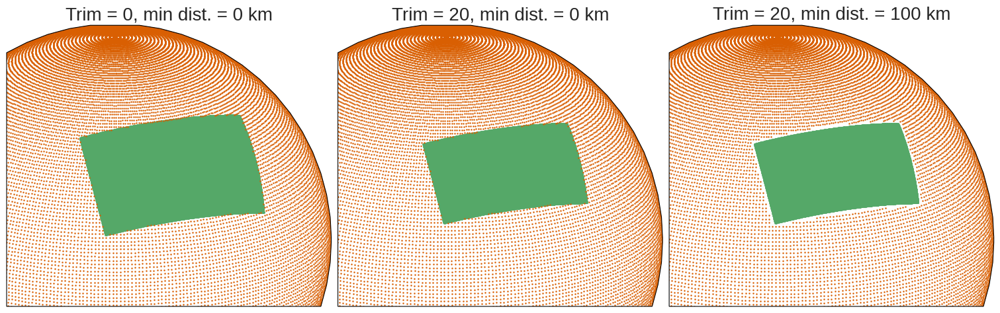

In [5]:
nrows = 1
ncols = len(adslist)

fig, axs = plt.subplots(
    nrows,
    ncols,
    figsize=(ncols*5, nrows*5),
    subplot_kw={"projection": ccrs.Orthographic(central_longitude=-120, central_latitude=20)},
)

for ads, trim, mdist, ax in zip(adslist, trimlist, distlist, axs):
    n_cutout = ads.grids[0]
    for i, (x,y) in enumerate(zip(
        [ads.longitudes[:n_cutout], ads.longitudes[n_cutout:]],
        [ads.latitudes[:n_cutout], ads.latitudes[n_cutout:]],
    )):
        ax.scatter(
            x, y,
            c=f"C{i}",
            s=2,
            transform=ccrs.PlateCarree(),
        )
        ax.set_extent([-150, 80, 0, 80], crs=ccrs.PlateCarree())
        ax.set(title=f"Trim = {trim}, min dist. = {mdist} km")

In [6]:
def get_precip_kwargs():                                                          
    n = 1                                                                         
    levels = np.concatenate(                                                      
        [                                                                         
            np.linspace(0, .1, 2*n),                                              
            np.linspace(.1, 1, 5*n),                                              
            np.linspace(1, 10, 5*n),                                              
            np.linspace(10, 50, 3*n),                                             
            #np.linspace(50, 80, 2),                                              
        ],                                                                        
    )                                                                             
    norm = BoundaryNorm(levels, len(levels)+1)                                    
    cmap = plt.get_cmap("cmo.rain", len(levels)+1)                                
    return {"norm": norm, "cmap": cmap, "cbar_kwargs": {"ticks": [0, 1, 10, 50]}} 

In [7]:
all_kwargs = {
    "accum_tp": get_precip_kwargs(),
    "t_surface": {"cmap": "cmo.thermal", "vmin": -10, "vmax": 30},
    "t2m": {"cmap": "cmo.thermal", "vmin": -10, "vmax": 30},
    "sh2": {"cmap": "cmo.haline_r", "vmin": 0, "vmax": 0.025},
    "u10": {"cmap": "cmo.balance", "vmin": -20, "vmax": 20},
    "v10": {"cmap": "cmo.balance", "vmin": -20, "vmax": 20},
}

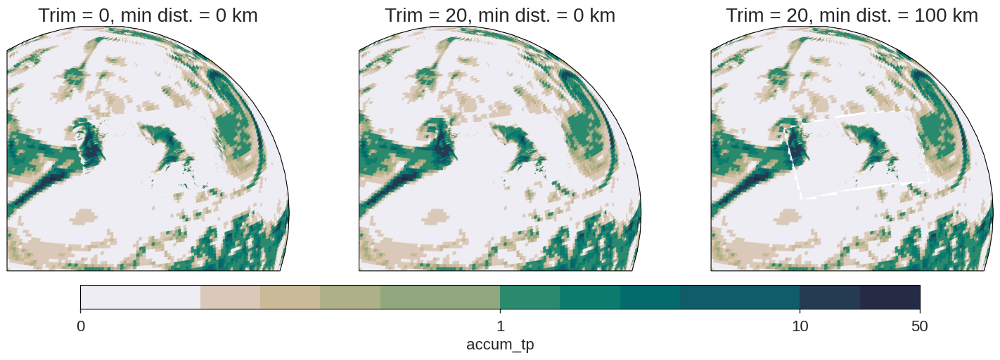

In [32]:
date = "2023-03-10T00"
varname = "accum_tp"

fig, axs = plt.subplots(
    nrows,
    ncols,
    figsize=(ncols*5, nrows*5),
    subplot_kw={"projection": ccrs.Orthographic(central_longitude=-120, central_latitude=20)},
)

kwargs = all_kwargs[varname].copy()
cbar_kwargs = kwargs.pop("cbar_kwargs", {})
offset = -273.15 if varname in ("t_surface", "t2m") else 0

for ads, trim, mdist, ax in zip(adslist, trimlist, distlist, axs):
    n_cutout = ads.grids[0]
    itime = ads.to_index(date=date, variable=0)[0]
    ivar = ads.variables.index(varname)
    for i, (slc,s) in enumerate(zip(
        [slice(None, n_cutout), slice(n_cutout, None)],
        [1/4, 20],
    )):
        pp = ax.scatter(
            ads.longitudes[slc],
            ads.latitudes[slc],
            c=ads[itime, ivar, 0, slc]+offset,
            s=s,
            transform=ccrs.PlateCarree(),
            **kwargs,
        )
        ax.set_extent([-150, 80, 0, 80], crs=ccrs.PlateCarree())
        ax.set(title=f"Trim = {trim}, min dist. = {mdist} km")

fig.colorbar(pp, ax=axs, orientation="horizontal", shrink=.8, pad=0.05, aspect=35, label=varname, **cbar_kwargs)
#fig.savefig(f"figures/trimtest_{varname}_{date}.jpeg", bbox_inches="tight", dpi=300)

In [21]:
def plot_trimdict(date, varnames, trimdict):
    varnames = list(varnames) if isinstance(varnames, str) else varnames

    nrows = len(varnames)
    ncols = len(trimdict)
    
    fig, axs = plt.subplots(
        nrows,
        ncols,
        figsize=(ncols*5, nrows*5),
        subplot_kw={"projection": ccrs.Orthographic(central_longitude=-120, central_latitude=20)},
    )

    if nrows == 1:
        axs = [axs]

    for varname, axr in zip(varnames, axs):
        kwargs = all_kwargs[varname].copy()
        cbar_kwargs = kwargs.pop("cbar_kwargs", {})
        offset = -273.15 if varname in ("t_surface", "t2m") else 0
        
        for (trim, ads), ax in zip(trimdict.items(), axr):
            itime = ads.to_index(date=date, variable=0)[0]
            ivar = ads.variables.index(varname)
            if trim == "GFS":
                ax.scatter(
                    ads.longitudes,
                    ads.latitudes,
                    c=ads[itime, ivar, 0, :]+offset,
                    s=1.5,
                    transform=ccrs.PlateCarree(),
                    **kwargs,
                )
            else:
                n_cutout = ads.grids[0]
                for i, (slc,s) in enumerate(zip(
                    [slice(None, n_cutout), slice(n_cutout, None)],
                    [1/4, 20],
                )):
                    pp = ax.scatter(
                        ads.longitudes[slc],
                        ads.latitudes[slc],
                        c=ads[itime, ivar, 0, slc]+offset,
                        s=s,
                        transform=ccrs.PlateCarree(),
                        **kwargs,
                    )
            ax.set_extent([-150, 80, 0, 80], crs=ccrs.PlateCarree())
            ax.set(title=f"Trim = {trim}" if trim != "GFS" else "GFS Analysis")
    
        plt.colorbar(pp, ax=axr[-1], orientation="vertical", shrink=.8, pad=0.05, label=varname, **cbar_kwargs)
    return fig, axs

In [26]:
adsdict = {
    trim: open_nested(trim_edge=trim, min_distance_km=0)
    for trim in [10, 15, 20]
}

Dataset /pscratch/sd/t/timothys/nested-eagle/v0/data/hrrr.zarr has missing dates
Dataset /pscratch/sd/t/timothys/nested-eagle/v0/data/gfs.zarr has missing dates
Dataset /pscratch/sd/t/timothys/nested-eagle/v0/data/hrrr.zarr has missing dates
Dataset /pscratch/sd/t/timothys/nested-eagle/v0/data/gfs.zarr has missing dates
Dataset /pscratch/sd/t/timothys/nested-eagle/v0/data/hrrr.zarr has missing dates
Dataset /pscratch/sd/t/timothys/nested-eagle/v0/data/gfs.zarr has missing dates


In [27]:
adsdict["GFS"] = open_dataset("/pscratch/sd/t/timothys/anemoi-house/gfs/0.25-degree/data/gfs.zarr")

Dataset /pscratch/sd/t/timothys/anemoi-house/gfs/0.25-degree/data/gfs.zarr has missing dates


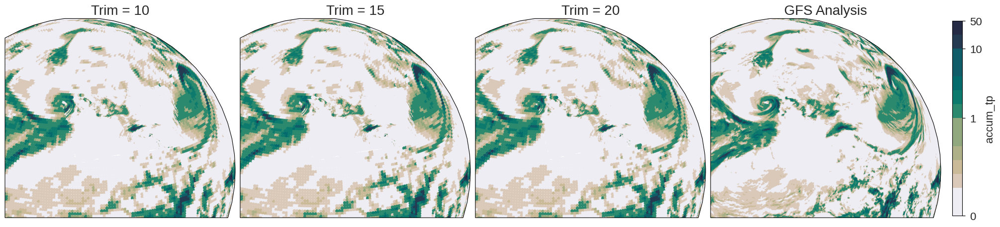

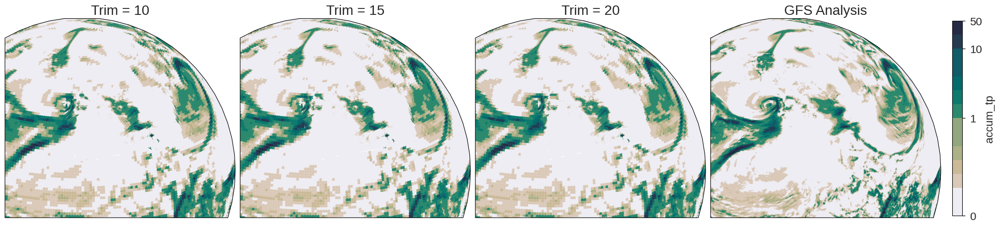

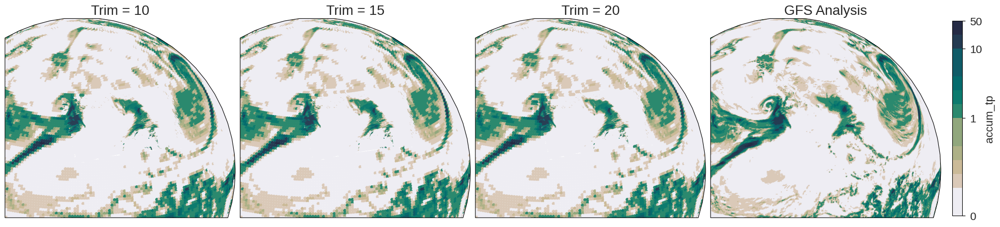

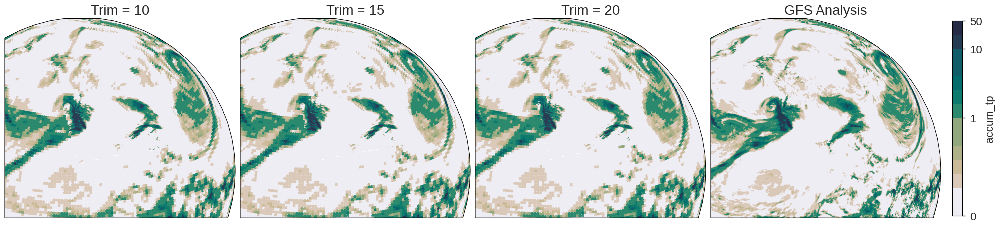

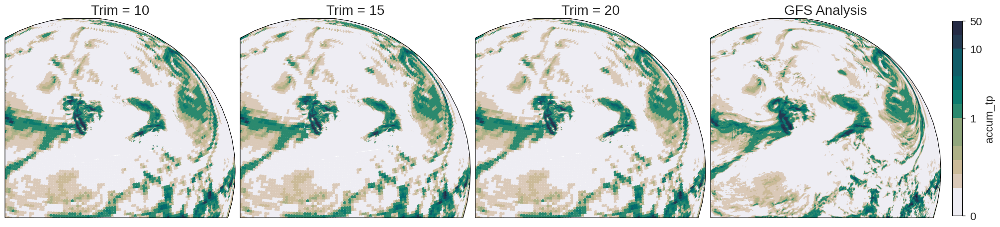

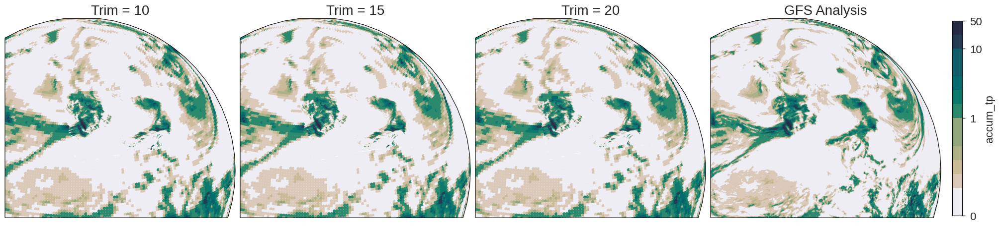

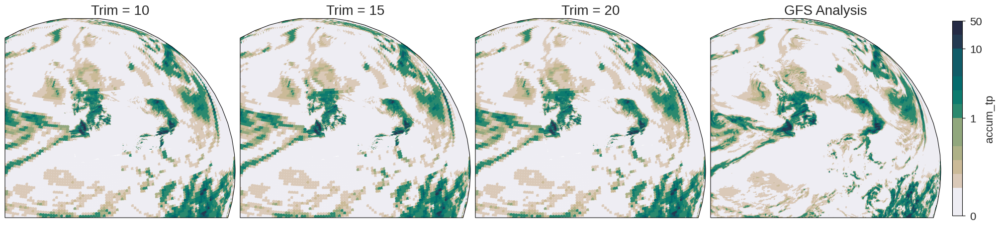

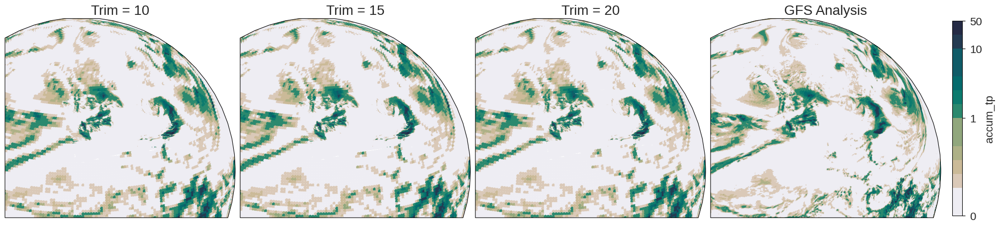

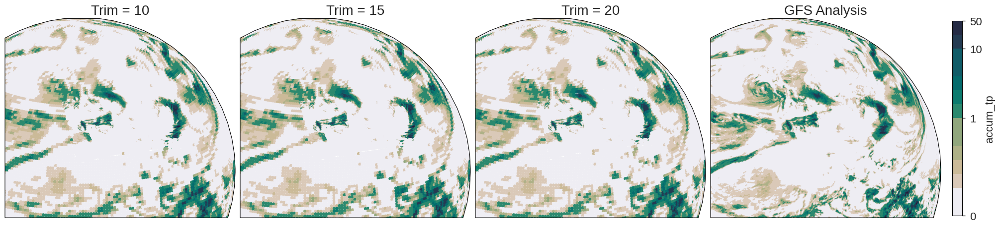

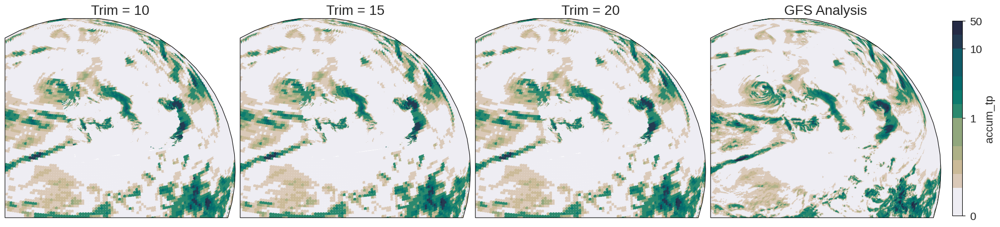

In [28]:
for date in [
    "2023-03-09T12",
    "2023-03-09T18",
    "2023-03-10T00",
    "2023-03-10T06",
    "2023-03-10T12",
    "2023-03-10T18",
    "2023-03-11T00",
    "2023-03-11T06",
    "2023-03-11T12",
    "2023-03-11T18",
]:
    plot_trimdict(
        date=date,
        varnames=["accum_tp"],
        trimdict=adsdict,
    );

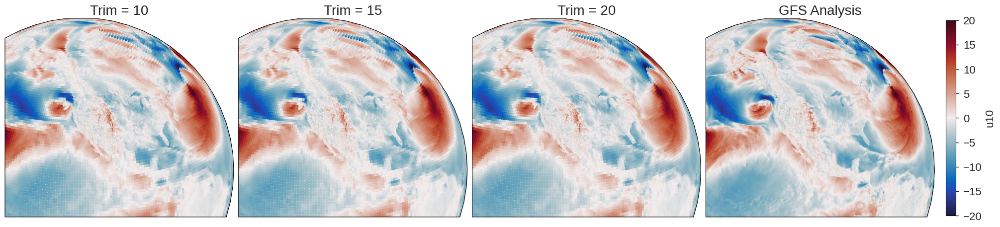

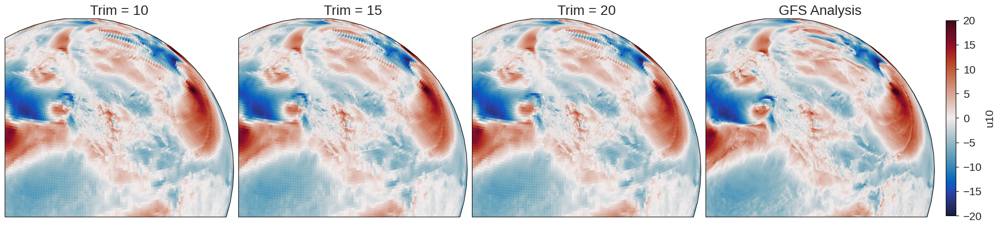

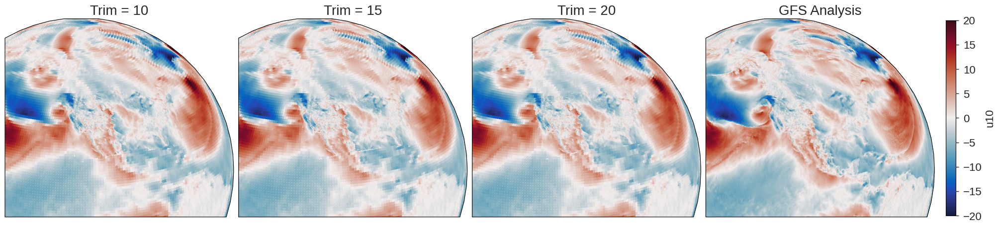

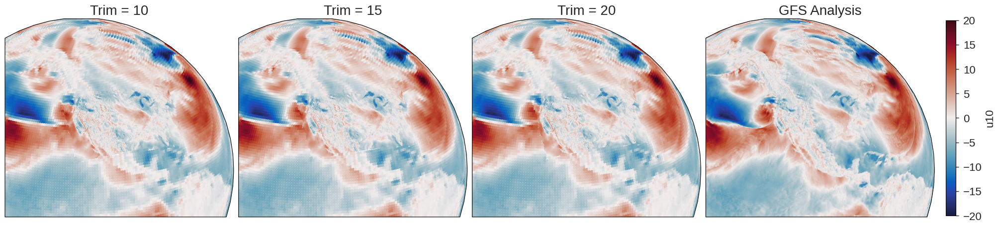

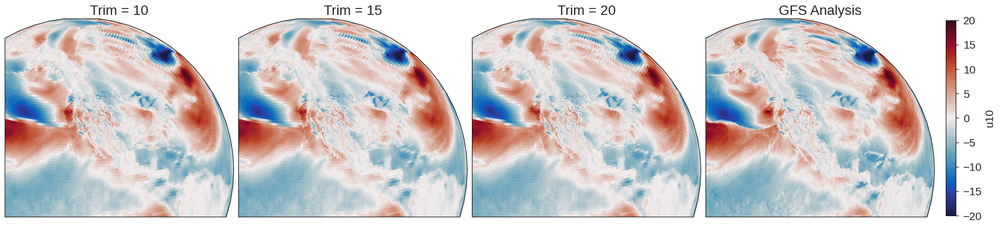

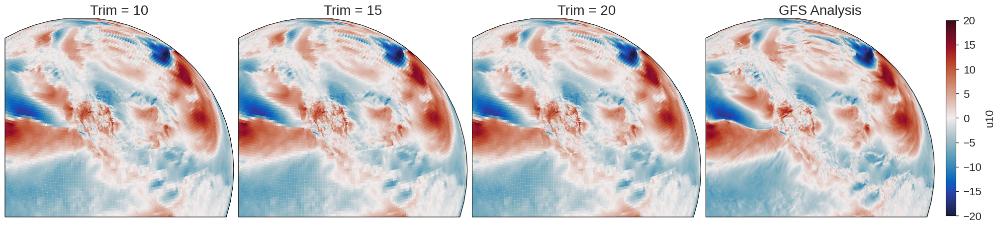

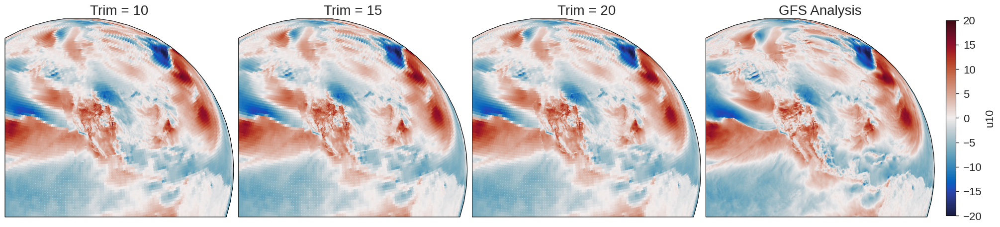

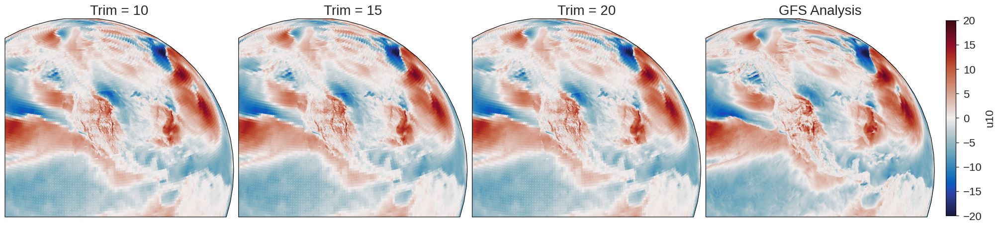

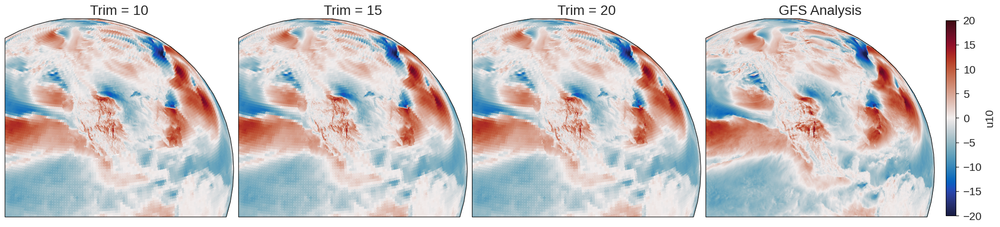

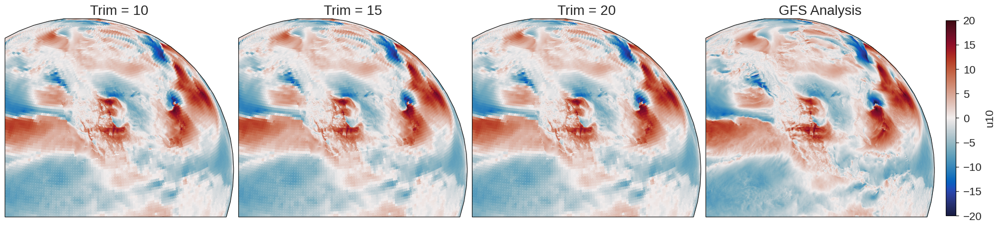

In [29]:
for date in [
    "2023-03-09T12",
    "2023-03-09T18",
    "2023-03-10T00",
    "2023-03-10T06",
    "2023-03-10T12",
    "2023-03-10T18",
    "2023-03-11T00",
    "2023-03-11T06",
    "2023-03-11T12",
    "2023-03-11T18",
]:
    plot_trimdict(
        date=date,
        varnames=["u10"],
        trimdict=adsdict,
    );